In [ ]:
!wget https://raw.githubusercontent.com/DHI/Intro_ML_course/main/module_6/Brahmaputra_images.zip

--2024-09-23 17:14:56--  https://raw.githubusercontent.com/DHI/Intro_ML_course/main/module_6/Brahmaputra_images.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 24454532 (23M) [application/zip]
Saving to: ‘Brahmaputra_images.zip.1’

Brahmaputra_images. 100%[===================>]  23.32M   137MB/s    in 0.2s    

2024-09-23 17:14:58 (137 MB/s) - ‘Brahmaputra_images.zip.1’ saved [24454532/24454532]



In [ ]:
!unzip Brahmaputra_images.zip

Archive:  Brahmaputra_images.zip
  inflating: Brahmaputra-2021-02-22T04.npy  
  inflating: Brahmaputra-2022-03-09T04.npy  
  inflating: Brahmaputra-2022-11-29T04.npy  
  inflating: Brahmaputra-2023-02-02T04.npy  


In [ ]:
# Necessary libraries
import matplotlib.pyplot as plt
import numpy as np
import numpy.random
import os
from sklearn.cluster import KMeans

In [ ]:
files = sorted([file for file in os.listdir('.') if file.endswith('.npy')])
images = [np.load(os.path.join('.', file)).astype('float') for file in files]
images = [np.moveaxis(image, source=0, destination=-1) for image in images]
images = [np.clip(image, 0, 1) for image in images]
print('There are', len(images), 'images of shape:', images[0].shape)

There are 4 images of shape: (1009, 1014, 4)


In [ ]:
rgb = (2, 1, 0) # red, green, blue bands

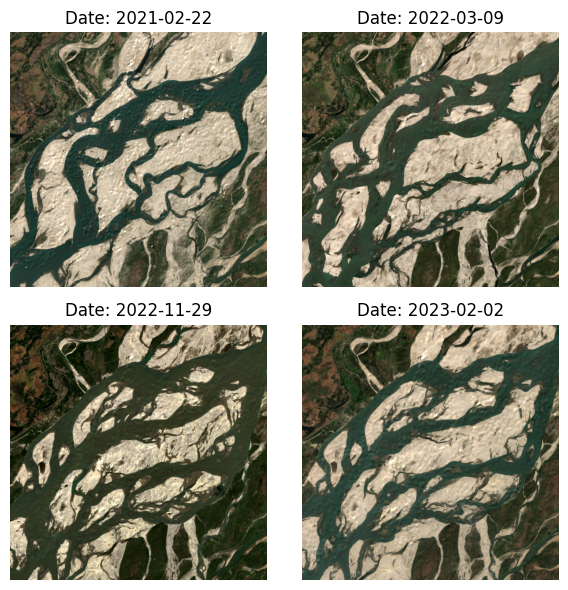

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(6, 6))
for i in range(2):
  for j in range(2):
      index = i * 2 + j
      axes[i, j].imshow(images[index][:, :, rgb])
      axes[i, j].set_title(f'Date: {files[index][12:22]}')
      axes[i, j].axis('off')
plt.tight_layout()
plt.show()

In [ ]:
false_colors = (3, 2, 0) # infrared, red, blue bands

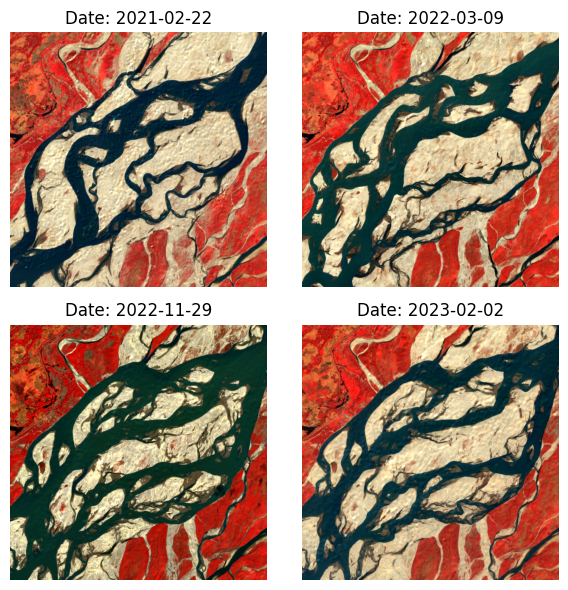

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(6, 6))
for i in range(2):
  for j in range(2):
      index = i * 2 + j
      axes[i, j].imshow(images[index][:, :, false_colors])
      axes[i, j].set_title(f'Date: {files[index][12:22]}')
      axes[i, j].axis('off')
plt.tight_layout()
plt.show()

In [ ]:
# transform the images into a long table
data = np.array(images).reshape(-1, 4)
data.shape

(4092504, 4)

In [ ]:
# we select only a random subset of pixels to display
sample_size = 100000
random_indices = np.random.choice(data.shape[0], size=10000, replace=False)
data_subset = data[random_indices]
data_subset.shape

(10000, 4)

(0.0, 1.0)

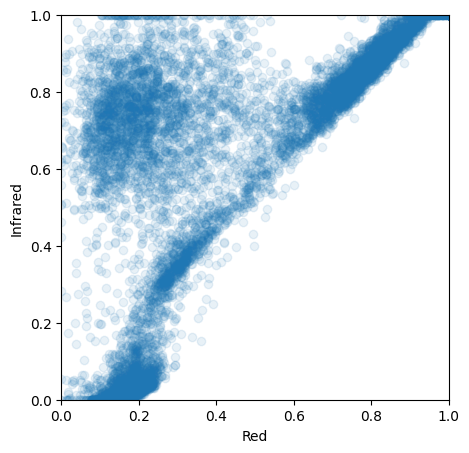

In [ ]:
fig = plt.figure(figsize=(5, 5))
plt.scatter(data_subset[:, 2], data_subset[:, 3], alpha=0.1)
plt.xlabel('Red')
plt.ylabel('Infrared')
plt.xlim(0, 1)
plt.ylim(0, 1)

In [ ]:
# Select a number of clusters
num_clusters = 5

In [ ]:
# Fit the K-Means model to cluster the selected data
kmeans = KMeans(n_clusters=num_clusters)
labels = kmeans.fit_predict(data_subset)

In [ ]:
# Retrieve the K-Means cluster centroids
cluster_centers = kmeans.cluster_centers_

(0.0, 1.0)

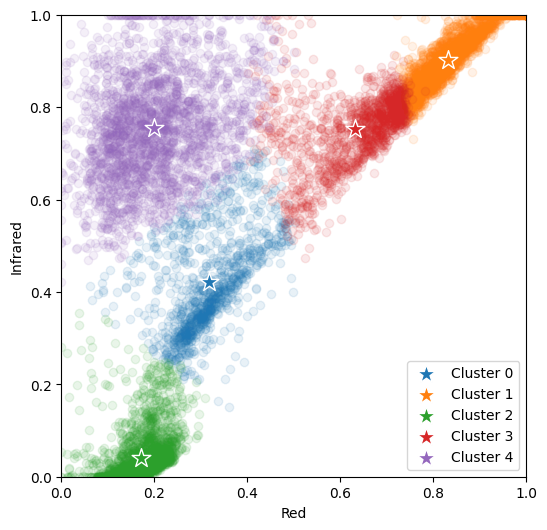

In [ ]:
fig = plt.figure(figsize=(6, 6))
colors = ['C0', 'C1', 'C2', 'C3', 'C4']
for i in range(num_clusters):
    # plot pixels in different colors
    plt.scatter(data_subset[labels==i, 2], data_subset[labels==i, 3],
                color=f'C{i}', alpha=0.1)
    # plot cluster centers as stars
    plt.scatter(cluster_centers[i, 2], cluster_centers[i, 3],
                color=f'C{i}', s=200, marker='*',
                edgecolors='white', label=f'Cluster {i}')
plt.xlabel('Red')
plt.ylabel('Infrared')
plt.legend()
plt.xlim(0, 1)
plt.ylim(0, 1)

In [ ]:
# Assign each pixel in the image to the nearest cluster centroid
assigned_clusters = kmeans.predict(data)

# Reshape the assigned clusters to the shape of the original image
assigned_clusters = assigned_clusters.reshape((4,) + images[0].shape[:2])

In [ ]:
assigned_clusters.shape

(4, 1009, 1014)

In [ ]:
cluster_colors = [[0, 128, 255], [255, 153, 51], [0, 153, 0],
 [204, 0, 0], [150, 0, 180]]

In [ ]:
# Use the assigned clusters and calculated colors to create an annotated image
annotated_image = np.zeros(assigned_clusters.shape + (3, ),  dtype=np.uint8)
for cluster_id in range(num_clusters):
    annotated_image[assigned_clusters == cluster_id] = cluster_colors[cluster_id]

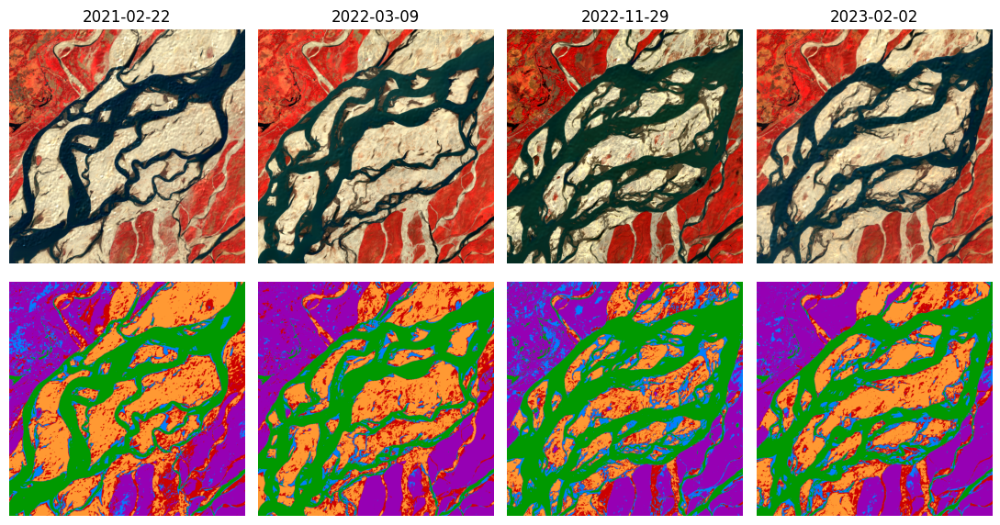

In [ ]:
fig, axes = plt.subplots(2, 4, figsize=(11, 6))
for i in range(4):
    axes[0, i].imshow(images[i][:, :, false_colors])
    axes[0, i].set_title(files[i][12:22])
    axes[0, i].axis('off')
    axes[1, i].imshow(annotated_image[i])
    axes[1, i].axis('off')
plt.tight_layout()
plt.show()

In [ ]:
# select the number of the cluster which corresponds to water
water_cluster = 1 # Change the '_' to a number between 0 and 3

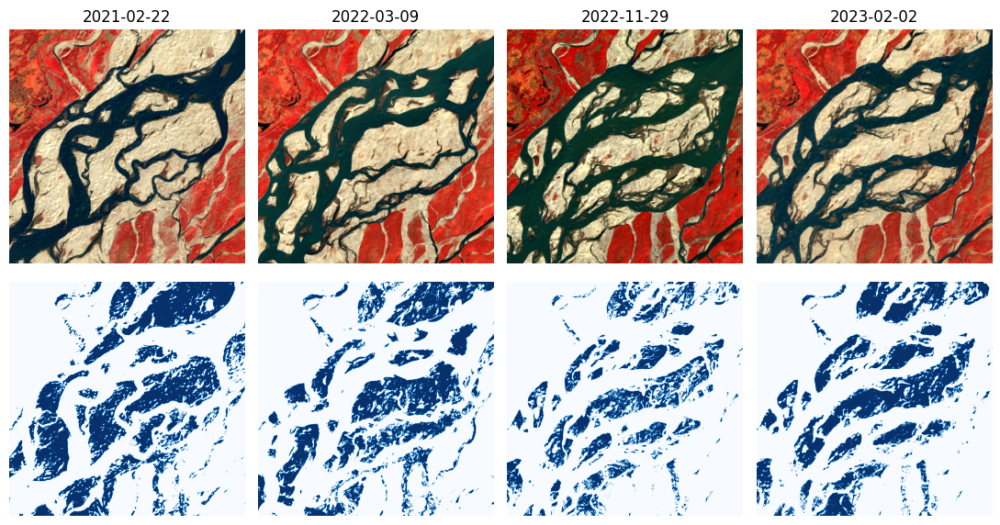

In [ ]:
fig, axes = plt.subplots(2, 4, figsize=(11, 6))
for i in range(4):
    axes[0, i].imshow(images[i][:, :, false_colors])
    axes[0, i].set_title(files[i][12:22])
    axes[0, i].axis('off')
    axes[1, i].imshow(assigned_clusters[i]==water_cluster, cmap='Blues')
    axes[1, i].axis('off')
plt.tight_layout()
plt.show()

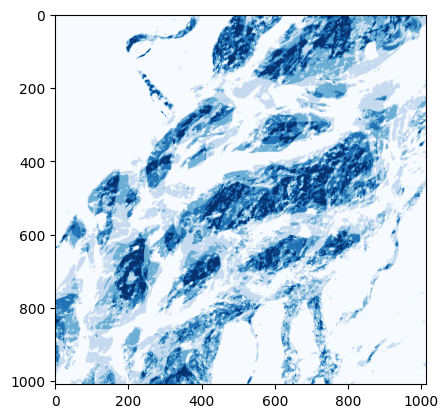

In [ ]:
plt.imshow(np.mean(assigned_clusters==water_cluster, axis=0), cmap='Blues')

In [ ]:
!pip install -U scikit-fuzzy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 920.8/920.8 kB 9.8 MB/s eta 0:00:00


In [ ]:
import numpy as np
import skfuzzy as fuzz
import matplotlib.pyplot as plt

In [ ]:
# transform the images into a long table
data = np.array(images).reshape(-1, 4)

In [ ]:
# we select only a random subset of pixels to display
sample_size = 100000
random_indices = np.random.choice(data.shape[0], size=10000, replace=False)
data_subset = data[random_indices]

In [ ]:
# Select a number of clusters
num_clusters = 5

In [ ]:
# Fit the Fuzzy C-Means model to the selected data
cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(
    data_subset.T, num_clusters, 2, error=0.005, maxiter=1000, init=None)

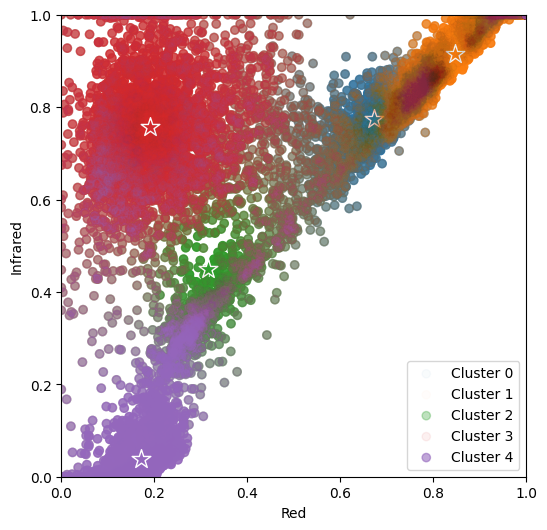

In [ ]:
# Retrieve the FCM cluster centers
cluster_centers = cntr

# Plot the data points with fuzzy membership in each cluster
fig = plt.figure(figsize=(6, 6))
colors = ['C0', 'C1', 'C2', 'C3', 'C4']
for i in range(num_clusters):
    # plot pixels with membership in different clusters
    plt.scatter(data_subset[:, 2], data_subset[:, 3], alpha=u[i], color=f'C{i}', label=f'Cluster {i}')
    # plot cluster centers as stars
    plt.scatter(cluster_centers[i, 2], cluster_centers[i, 3],
                color=f'C{i}', s=200, marker='*', edgecolors='white')

plt.xlabel('Red')
plt.ylabel('Infrared')
plt.legend()
plt.xlim(0, 1)
plt.ylim(0, 1)
plt.show()

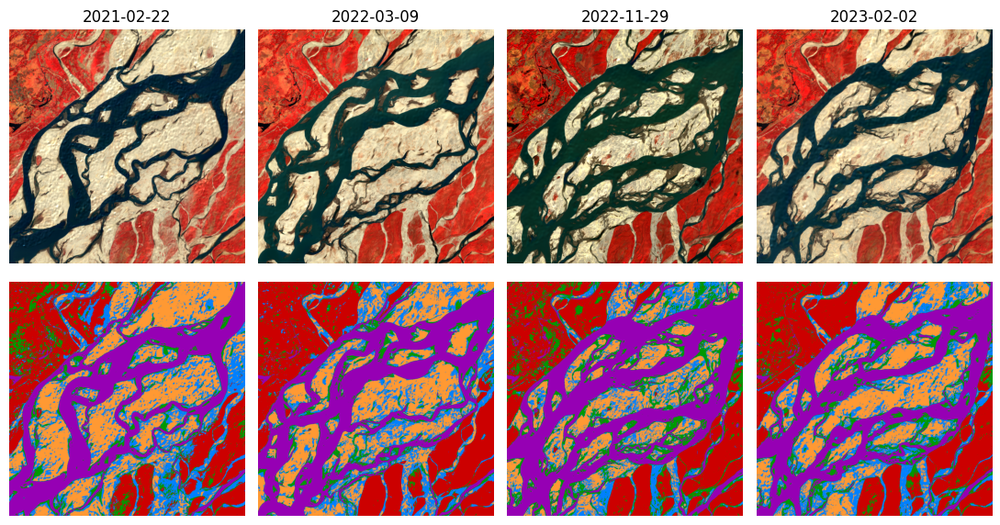

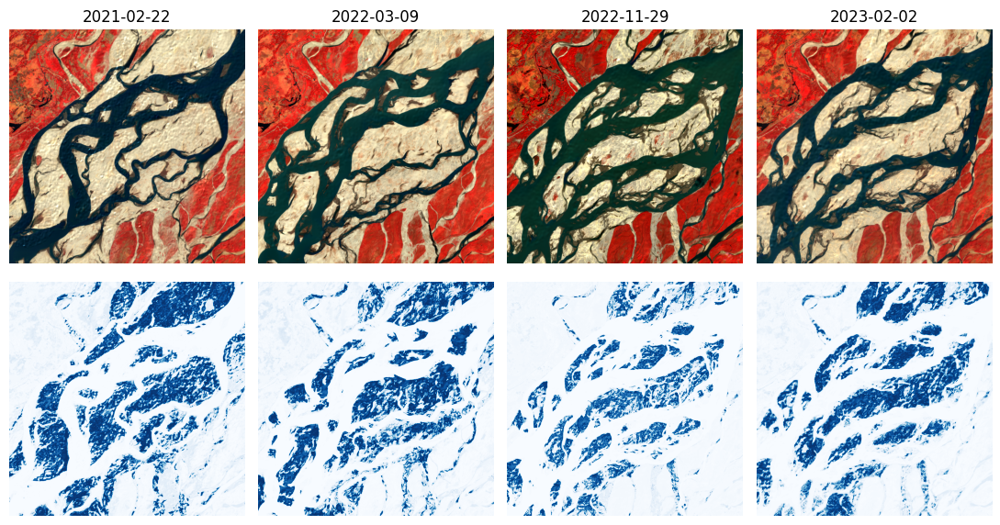

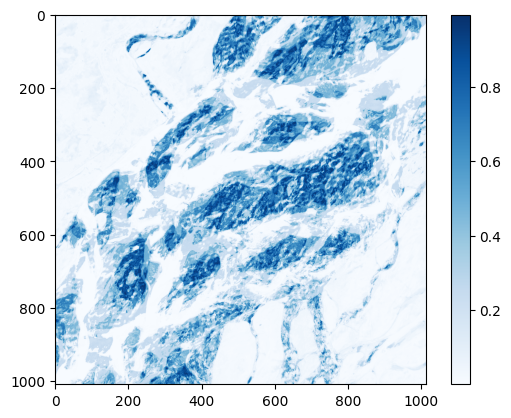

In [ ]:
# Assign each pixel in the image to the cluster with the highest membership value
u_full, u0, d, jm, p, fpc = fuzz.cluster.cmeans_predict(data.T, cntr, 2, error=0.005, maxiter=1000)

# Get the cluster assignment (maximum membership) for each pixel
assigned_clusters = np.argmax(u_full, axis=0)

# Reshape the assigned clusters to the shape of the original image
assigned_clusters = assigned_clusters.reshape((4,) + images[0].shape[:2])

# Define the colors for each cluster
cluster_colors = [[0, 128, 255], [255, 153, 51], [0, 153, 0], [204, 0, 0], [150, 0, 180]]

# Use the assigned clusters and calculated colors to create an annotated image
annotated_image = np.zeros(assigned_clusters.shape + (3,), dtype=np.uint8)
for cluster_id in range(num_clusters):
    annotated_image[assigned_clusters == cluster_id] = cluster_colors[cluster_id]

# Plot the original and clustered images
fig, axes = plt.subplots(2, 4, figsize=(11, 6))
for i in range(4):
    axes[0, i].imshow(images[i][:, :, false_colors])
    axes[0, i].set_title(files[i][12:22])
    axes[0, i].axis('off')
    axes[1, i].imshow(annotated_image[i])
    axes[1, i].axis('off')
plt.tight_layout()
plt.show()

# Select the number of the cluster which corresponds to water
water_cluster = 1  # Adjust this number based on cluster analysis

fig, axes = plt.subplots(2, 4, figsize=(11, 6))
for i in range(4):
    axes[0, i].imshow(images[i][:, :, false_colors])
    axes[0, i].set_title(files[i][12:22])
    axes[0, i].axis('off')
    # Visualize the membership of the water cluster
    water_membership = u_full[water_cluster].reshape((4,) + images[0].shape[:2])
    axes[1, i].imshow(water_membership[i], cmap='Blues', vmin=0, vmax=1)
    axes[1, i].axis('off')
plt.tight_layout()
plt.show()

# Plot the mean membership for the water cluster across all images
plt.imshow(np.mean(u_full[water_cluster].reshape((4,) + images[0].shape[:2]), axis=0), cmap='Blues')
plt.colorbar()
plt.show()

In [ ]:
!pip install scikit-fuzzy tensorflow keras

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.5781 - loss: 1.1960
Epoch 2/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9162 - loss: 0.2958
Epoch 3/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9488 - loss: 0.1422
Epoch 4/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9578 - loss: 0.1114
Epoch 5/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9594 - loss: 0.1052
Epoch 6/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9582 - loss: 0.1039
Epoch 7/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9584 - loss: 0.0945
Epoch 8/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9647 - loss: 0.0889
Epoch 9/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9630 - loss: 0.0893
Epoch 10/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9662 - loss: 0.0848
Epoch 11/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9642 - loss: 0.0834
Epoch 12/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9639 - lo

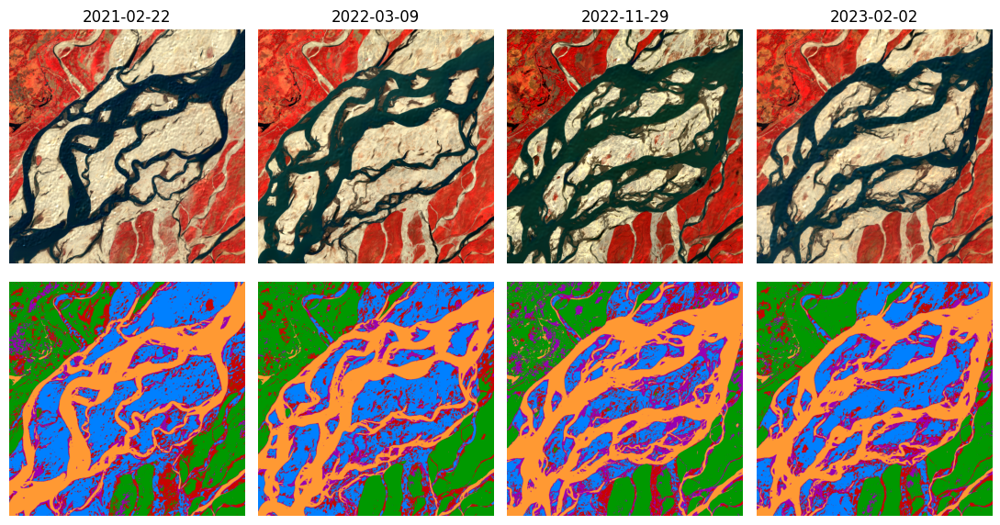

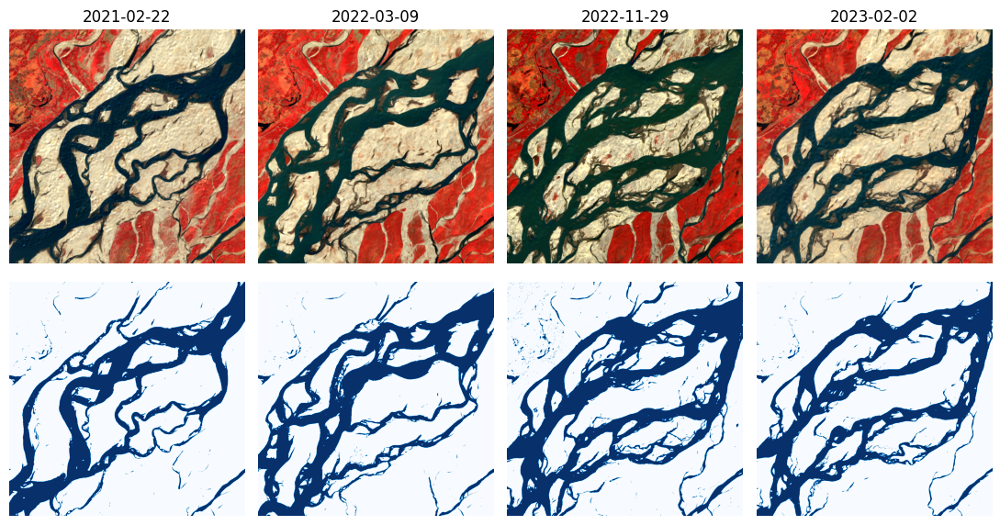

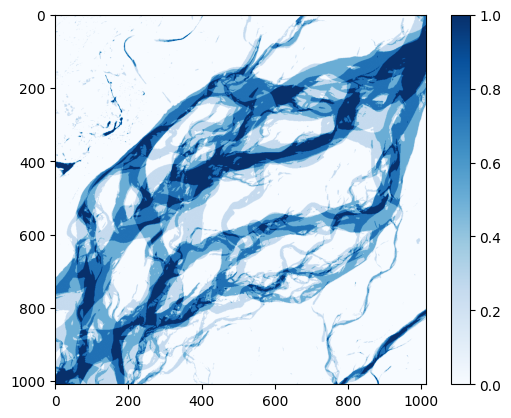

In [ ]:
import numpy as np
import skfuzzy as fuzz
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
import matplotlib.pyplot as plt

# Step 1: Transform the images into a long table
data = np.array(images).reshape(-1, 4)

# Step 2: Select only a random subset of pixels to display
sample_size = 100000
random_indices = np.random.choice(data.shape[0], size=10000, replace=False)
data_subset = data[random_indices]

# Step 3: Fuzzification (define fuzzy membership functions)
# We will fuzzify the Red and Infrared bands for each pixel

# Define fuzzy membership functions for Red and Infrared bands
red_band = data_subset[:, 2]
infrared_band = data_subset[:, 3]

# Define membership functions (fuzzy sets)
red_low = fuzz.trapmf(red_band, [0, 0, 0.2, 0.4])
red_medium = fuzz.trimf(red_band, [0.2, 0.5, 0.8])
red_high = fuzz.trapmf(red_band, [0.6, 0.8, 1, 1])

infra_low = fuzz.trapmf(infrared_band, [0, 0, 0.2, 0.4])
infra_medium = fuzz.trimf(infrared_band, [0.2, 0.5, 0.8])
infra_high = fuzz.trapmf(infrared_band, [0.6, 0.8, 1, 1])

# Combine fuzzy membership features into a matrix for FNN
fuzzy_features = np.vstack([red_low, red_medium, red_high, infra_low, infra_medium, infra_high]).T

# Step 4: Build the Neural Network
# We use a simple feed-forward neural network with a few dense layers

model = Sequential([
    Dense(32, input_shape=(fuzzy_features.shape[1],), activation='relu'),
    Dense(64, activation='relu'),
    Dense(32, activation='relu'),
    Dense(num_clusters, activation='softmax')  # Output layer with softmax for classification into num_clusters
])

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Prepare labels for training
# For the sake of demonstration, we assume you have ground truth labels available
# If not, this will have to be unsupervised clustering
from sklearn.preprocessing import LabelBinarizer
lb = LabelBinarizer()
labels = kmeans.fit_predict(data_subset)  # Replace kmeans with actual labels if available
labels_one_hot = lb.fit_transform(labels)

# Step 5: Train the Neural Network
model.fit(fuzzy_features, labels_one_hot, epochs=20, batch_size=128)

# Step 6: Use the trained model to classify all pixels in the original image
# Apply the fuzzy membership functions to the full dataset

# Fuzzify the entire dataset
red_full = data[:, 2]
infra_full = data[:, 3]

red_low_full = fuzz.trapmf(red_full, [0, 0, 0.2, 0.4])
red_medium_full = fuzz.trimf(red_full, [0.2, 0.5, 0.8])
red_high_full = fuzz.trapmf(red_full, [0.6, 0.8, 1, 1])

infra_low_full = fuzz.trapmf(infra_full, [0, 0, 0.2, 0.4])
infra_medium_full = fuzz.trimf(infra_full, [0.2, 0.5, 0.8])
infra_high_full = fuzz.trapmf(infra_full, [0.6, 0.8, 1, 1])

# Combine fuzzy membership features for the entire dataset
fuzzy_features_full = np.vstack([red_low_full, red_medium_full, red_high_full,
                                 infra_low_full, infra_medium_full, infra_high_full]).T

# Predict the cluster labels for each pixel using the trained FNN
assigned_clusters = np.argmax(model.predict(fuzzy_features_full), axis=1)

# Reshape the assigned clusters to the shape of the original image
assigned_clusters = assigned_clusters.reshape((4,) + images[0].shape[:2])

# Step 7: Visualization of clusters
cluster_colors = [[0, 128, 255], [255, 153, 51], [0, 153, 0], [204, 0, 0], [150, 0, 180]]

# Use the assigned clusters and calculated colors to create an annotated image
annotated_image = np.zeros(assigned_clusters.shape + (3,), dtype=np.uint8)
for cluster_id in range(num_clusters):
    annotated_image[assigned_clusters == cluster_id] = cluster_colors[cluster_id]

# Plot the original and clustered images
fig, axes = plt.subplots(2, 4, figsize=(11, 6))
for i in range(4):
    axes[0, i].imshow(images[i][:, :, false_colors])
    axes[0, i].set_title(files[i][12:22])
    axes[0, i].axis('off')
    axes[1, i].imshow(annotated_image[i])
    axes[1, i].axis('off')
plt.tight_layout()
plt.show()

# Select the cluster corresponding to water
water_cluster = 1  # Adjust based on analysis

fig, axes = plt.subplots(2, 4, figsize=(11, 6))
for i in range(4):
    axes[0, i].imshow(images[i][:, :, false_colors])
    axes[0, i].set_title(files[i][12:22])
    axes[0, i].axis('off')
    axes[1, i].imshow(assigned_clusters[i] == water_cluster, cmap='Blues')
    axes[1, i].axis('off')
plt.tight_layout()
plt.show()

# Mean membership visualization for the water cluster
plt.imshow(np.mean(assigned_clusters == water_cluster, axis=0), cmap='Blues')
plt.colorbar()
plt.show()


Epoch 1/20


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


79/79 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.1200
Epoch 2/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0320
Epoch 3/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0230
Epoch 4/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0199
Epoch 5/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0175
Epoch 6/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0160
Epoch 7/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0145
Epoch 8/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0145
Epoch 9/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0138
Epoch 10/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0141
Epoch 11/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0139
Epoch 12/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0124
Epoch 13/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0126
Epoch 14/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0126
Epoch 15/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0124
Epoch 16/20
79/79 ━━━━━━━━━━━━

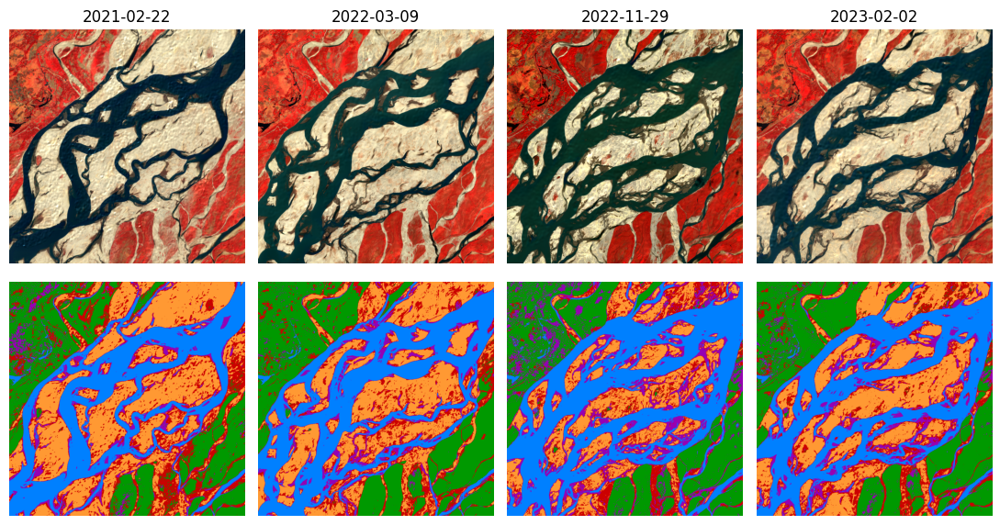

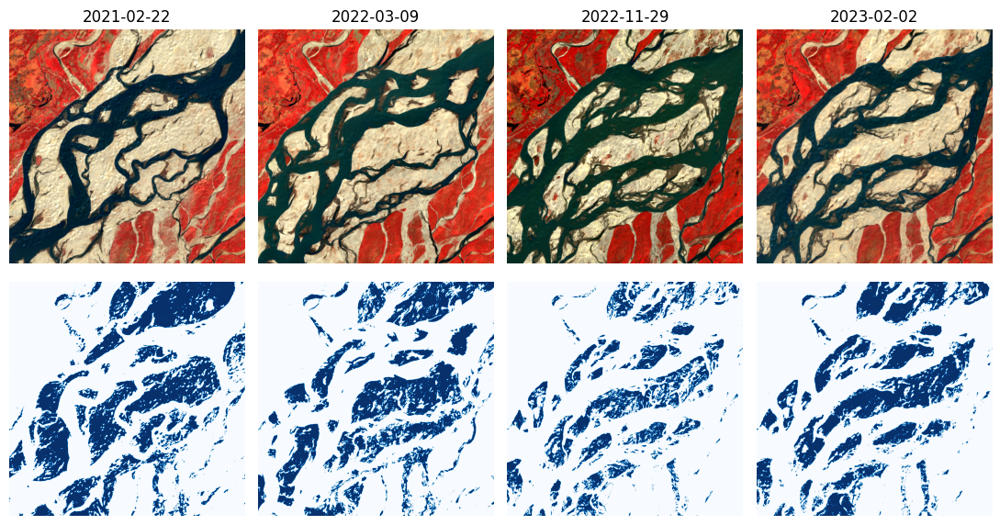

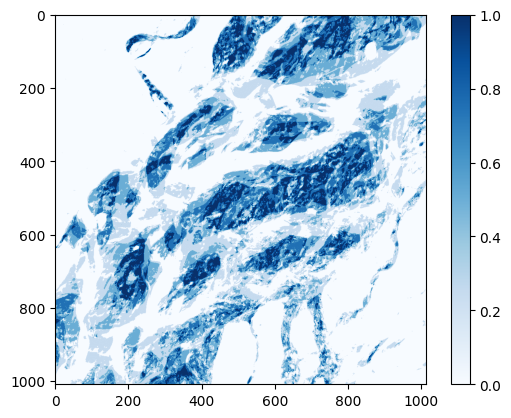

In [ ]:
import numpy as np
import skfuzzy as fuzz
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
import matplotlib.pyplot as plt

# Step 1: Transform the images into a long table
data = np.array(images).reshape(-1, 4)

# Step 2: Select only a random subset of pixels to display
sample_size = 100000
random_indices = np.random.choice(data.shape[0], size=10000, replace=False)
data_subset = data[random_indices]

# Step 3: Fuzzification (define fuzzy membership functions)
# We will fuzzify the Red and Infrared bands for each pixel

# Define fuzzy membership functions for Red and Infrared bands
red_band = data_subset[:, 2]
infrared_band = data_subset[:, 3]

# Define membership functions (fuzzy sets)
red_low = fuzz.trapmf(red_band, [0, 0, 0.2, 0.4])
red_medium = fuzz.trimf(red_band, [0.2, 0.5, 0.8])
red_high = fuzz.trapmf(red_band, [0.6, 0.8, 1, 1])

infra_low = fuzz.trapmf(infrared_band, [0, 0, 0.2, 0.4])
infra_medium = fuzz.trimf(infrared_band, [0.2, 0.5, 0.8])
infra_high = fuzz.trapmf(infrared_band, [0.6, 0.8, 1, 1])

# Combine fuzzy membership features into a matrix for FNN
fuzzy_features = np.vstack([red_low, red_medium, red_high, infra_low, infra_medium, infra_high]).T

# Step 4: Implement the Takagi-Sugeno Neural Network
# The TS model will have a rule for each fuzzy set combination
# Output of each rule is a linear function of inputs (Takagi-Sugeno)

# Create the neural network
# Input: fuzzy_features, Output: fuzzy rule consequents
model = Sequential([
    Dense(32, input_shape=(fuzzy_features.shape[1],), activation='relu'),
    Dense(64, activation='relu'),
    Dense(num_clusters, activation='linear')  # Output layer with linear activation for TS model
])

# Compile the model
model.compile(optimizer='adam', loss='mse')

# Prepare labels for training
# For simplicity, we'll assume labels are derived from KMeans or ground truth labels
from sklearn.preprocessing import LabelBinarizer
lb = LabelBinarizer()
labels = kmeans.fit_predict(data_subset)  # You can replace this with actual labels if available
labels_one_hot = lb.fit_transform(labels)

# Step 5: Train the Takagi-Sugeno Neural Network
model.fit(fuzzy_features, labels_one_hot, epochs=20, batch_size=128)

# Step 6: Use the trained model to classify all pixels in the original image
# Apply the fuzzy membership functions to the full dataset

# Fuzzify the entire dataset
red_full = data[:, 2]
infra_full = data[:, 3]

red_low_full = fuzz.trapmf(red_full, [0, 0, 0.2, 0.4])
red_medium_full = fuzz.trimf(red_full, [0.2, 0.5, 0.8])
red_high_full = fuzz.trapmf(red_full, [0.6, 0.8, 1, 1])

infra_low_full = fuzz.trapmf(infra_full, [0, 0, 0.2, 0.4])
infra_medium_full = fuzz.trimf(infra_full, [0.2, 0.5, 0.8])
infra_high_full = fuzz.trapmf(infra_full, [0.6, 0.8, 1, 1])

# Combine fuzzy membership features for the entire dataset
fuzzy_features_full = np.vstack([red_low_full, red_medium_full, red_high_full,
                                 infra_low_full, infra_medium_full, infra_high_full]).T

# Predict the cluster labels for each pixel using the trained TS-FNN
assigned_clusters = np.argmax(model.predict(fuzzy_features_full), axis=1)

# Reshape the assigned clusters to the shape of the original image
assigned_clusters = assigned_clusters.reshape((4,) + images[0].shape[:2])

# Step 7: Visualization of clusters
cluster_colors = [[0, 128, 255], [255, 153, 51], [0, 153, 0], [204, 0, 0], [150, 0, 180]]

# Use the assigned clusters and calculated colors to create an annotated image
annotated_image = np.zeros(assigned_clusters.shape + (3,), dtype=np.uint8)
for cluster_id in range(num_clusters):
    annotated_image[assigned_clusters == cluster_id] = cluster_colors[cluster_id]

# Plot the original and clustered images
fig, axes = plt.subplots(2, 4, figsize=(11, 6))
for i in range(4):
    axes[0, i].imshow(images[i][:, :, false_colors])
    axes[0, i].set_title(files[i][12:22])
    axes[0, i].axis('off')
    axes[1, i].imshow(annotated_image[i])
    axes[1, i].axis('off')
plt.tight_layout()
plt.show()

# Select the cluster corresponding to water
water_cluster = 1  # Adjust based on analysis

fig, axes = plt.subplots(2, 4, figsize=(11, 6))
for i in range(4):
    axes[0, i].imshow(images[i][:, :, false_colors])
    axes[0, i].set_title(files[i][12:22])
    axes[0, i].axis('off')
    axes[1, i].imshow(assigned_clusters[i] == water_cluster, cmap='Blues')
    axes[1, i].axis('off')
plt.tight_layout()
plt.show()

# Mean membership visualization for the water cluster
plt.imshow(np.mean(assigned_clusters == water_cluster, axis=0), cmap='Blues')
plt.colorbar()
plt.show()


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.5630 - loss: 1.3084
Epoch 2/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8616 - loss: 0.4620
Epoch 3/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9102 - loss: 0.2614
Epoch 4/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9177 - loss: 0.2085
Epoch 5/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9227 - loss: 0.1849
Epoch 6/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9279 - loss: 0.1772
Epoch 7/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9330 - loss: 0.1640
Epoch 8/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9398 - loss: 0.1521
Epoch 9/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9369 - loss: 0.1482
Epoch 10/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9466 - loss: 0.1350
Epoch 11/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9437 - loss: 0.1371
Epoch 12/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9445 - lo

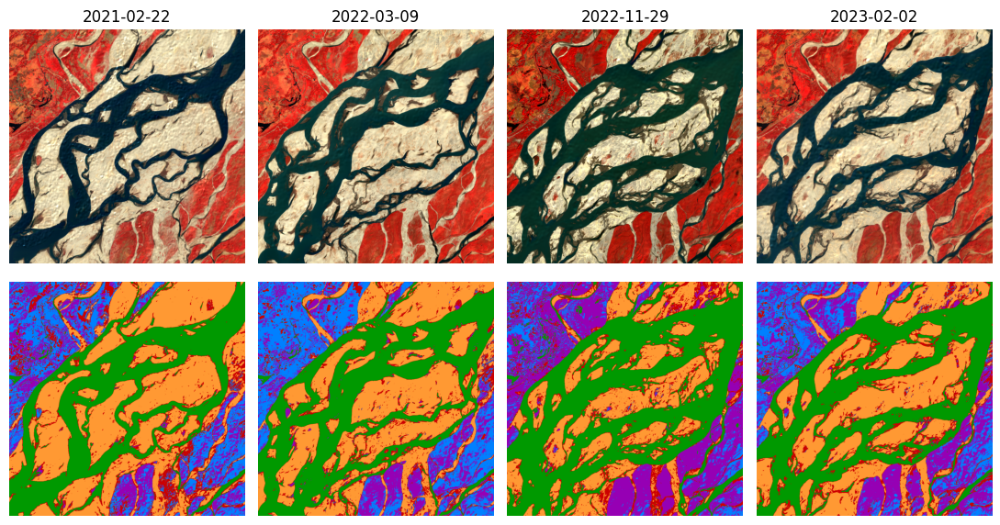

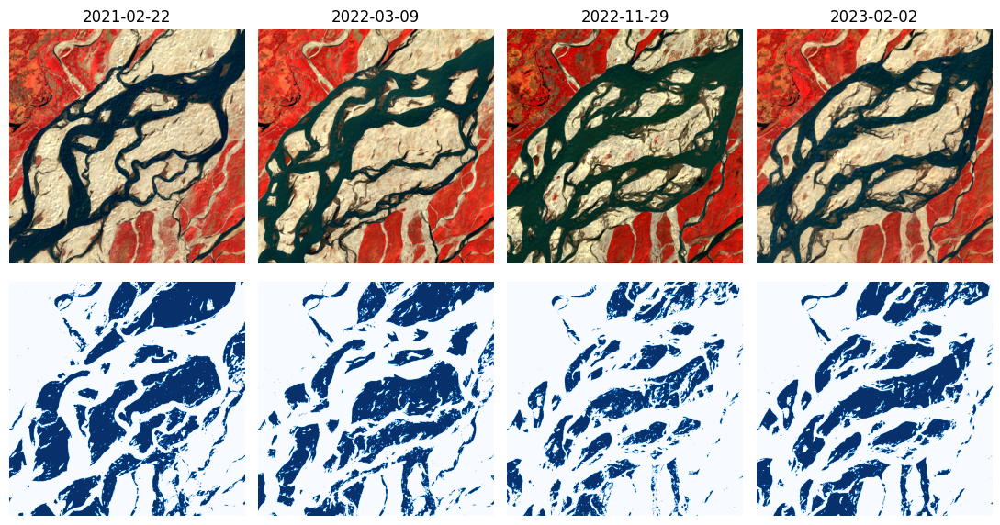

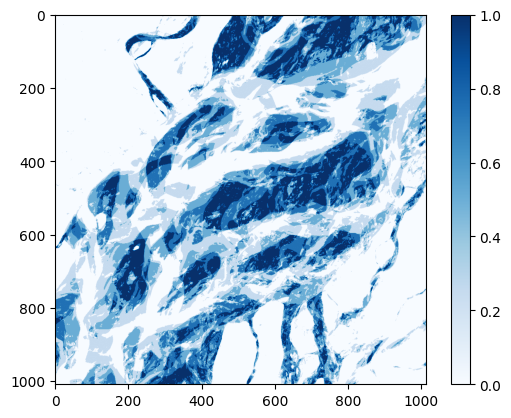

In [ ]:
import numpy as np
import skfuzzy as fuzz
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
import matplotlib.pyplot as plt

# Step 1: Transform the images into a long table
data = np.array(images).reshape(-1, 4)

# Step 2: Select only a random subset of pixels to display
sample_size = 100000
random_indices = np.random.choice(data.shape[0], size=10000, replace=False)
data_subset = data[random_indices]

# Step 3: Fuzzification (define fuzzy membership functions)
# We will fuzzify the Red and Infrared bands for each pixel

# Define fuzzy membership functions for Red and Infrared bands
red_band = data_subset[:, 2]
infrared_band = data_subset[:, 3]

# Define membership functions (fuzzy sets)
red_low = fuzz.trapmf(red_band, [0, 0, 0.2, 0.4])
red_medium = fuzz.trimf(red_band, [0.2, 0.5, 0.8])
red_high = fuzz.trapmf(red_band, [0.6, 0.8, 1, 1])

infra_low = fuzz.trapmf(infrared_band, [0, 0, 0.2, 0.4])
infra_medium = fuzz.trimf(infrared_band, [0.2, 0.5, 0.8])
infra_high = fuzz.trapmf(infrared_band, [0.6, 0.8, 1, 1])

# Combine fuzzy membership features into a matrix for NEFCLASS
fuzzy_features = np.vstack([red_low, red_medium, red_high, infra_low, infra_medium, infra_high]).T

# Step 4: Implement NEFCLASS Neural Network
# We will create a neural network that learns fuzzy rules and classifies the data

model = Sequential([
    Dense(32, input_shape=(fuzzy_features.shape[1],), activation='relu'),  # First layer to represent rules
    Dropout(0.3),  # Dropout for regularization
    Dense(64, activation='relu'),  # Hidden layer to combine rules
    Dense(num_clusters, activation='softmax')  # Output layer with softmax for classification into num_clusters
])

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Prepare labels for training
# We assume labels are derived from KMeans or actual ground truth labels
from sklearn.preprocessing import LabelBinarizer
lb = LabelBinarizer()
labels = kmeans.fit_predict(data_subset)  # Replace with actual labels if available
labels_one_hot = lb.fit_transform(labels)

# Step 5: Train the NEFCLASS Neural Network
model.fit(fuzzy_features, labels_one_hot, epochs=20, batch_size=128)

# Step 6: Use the trained model to classify all pixels in the original image
# Apply the fuzzy membership functions to the full dataset

# Fuzzify the entire dataset
red_full = data[:, 2]
infra_full = data[:, 3]

red_low_full = fuzz.trapmf(red_full, [0, 0, 0.2, 0.4])
red_medium_full = fuzz.trimf(red_full, [0.2, 0.5, 0.8])
red_high_full = fuzz.trapmf(red_full, [0.6, 0.8, 1, 1])

infra_low_full = fuzz.trapmf(infra_full, [0, 0, 0.2, 0.4])
infra_medium_full = fuzz.trimf(infra_full, [0.2, 0.5, 0.8])
infra_high_full = fuzz.trapmf(infra_full, [0.6, 0.8, 1, 1])

# Combine fuzzy membership features for the entire dataset
fuzzy_features_full = np.vstack([red_low_full, red_medium_full, red_high_full,
                                 infra_low_full, infra_medium_full, infra_high_full]).T

# Predict the cluster labels for each pixel using the trained NEFCLASS
assigned_clusters = np.argmax(model.predict(fuzzy_features_full), axis=1)

# Reshape the assigned clusters to the shape of the original image
assigned_clusters = assigned_clusters.reshape((4,) + images[0].shape[:2])

# Step 7: Visualization of clusters
cluster_colors = [[0, 128, 255], [255, 153, 51], [0, 153, 0], [204, 0, 0], [150, 0, 180]]

# Use the assigned clusters and calculated colors to create an annotated image
annotated_image = np.zeros(assigned_clusters.shape + (3,), dtype=np.uint8)
for cluster_id in range(num_clusters):
    annotated_image[assigned_clusters == cluster_id] = cluster_colors[cluster_id]

# Plot the original and clustered images
fig, axes = plt.subplots(2, 4, figsize=(11, 6))
for i in range(4):
    axes[0, i].imshow(images[i][:, :, false_colors])
    axes[0, i].set_title(files[i][12:22])
    axes[0, i].axis('off')
    axes[1, i].imshow(annotated_image[i])
    axes[1, i].axis('off')
plt.tight_layout()
plt.show()

# Select the cluster corresponding to water
water_cluster = 1  # Adjust based on analysis

fig, axes = plt.subplots(2, 4, figsize=(11, 6))
for i in range(4):
    axes[0, i].imshow(images[i][:, :, false_colors])
    axes[0, i].set_title(files[i][12:22])
    axes[0, i].axis('off')
    axes[1, i].imshow(assigned_clusters[i] == water_cluster, cmap='Blues')
    axes[1, i].axis('off')
plt.tight_layout()
plt.show()

# Mean membership visualization for the water cluster
plt.imshow(np.mean(assigned_clusters == water_cluster, axis=0), cmap='Blues')
plt.colorbar()
plt.show()


In [ ]:
# Necessary libraries
import matplotlib.pyplot as plt
import numpy as np
import numpy.random
import os
from sklearn.cluster import KMeans

In [ ]:
!wget https://raw.githubusercontent.com/DHI/Intro_ML_course/main/module_6/Brahmaputra_images.zip
!unzip Brahmaputra_images.zip

--2024-09-26 14:34:48--  https://raw.githubusercontent.com/DHI/Intro_ML_course/main/module_6/Brahmaputra_images.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 24454532 (23M) [application/zip]
Saving to: ‘Brahmaputra_images.zip’

Brahmaputra_images. 100%[===================>]  23.32M  76.6MB/s    in 0.3s    

2024-09-26 14:34:49 (76.6 MB/s) - ‘Brahmaputra_images.zip’ saved [24454532/24454532]

Archive:  Brahmaputra_images.zip
  inflating: Brahmaputra-2021-02-22T04.npy  
  inflating: Brahmaputra-2022-03-09T04.npy  
  inflating: Brahmaputra-2022-11-29T04.npy  
  inflating: Brahmaputra-2023-02-02T04.npy  


In [ ]:
files = sorted([file for file in os.listdir('.') if file.endswith('.npy')])
images = [np.load(os.path.join('.', file)).astype('float') for file in files]
images = [np.moveaxis(image, source=0, destination=-1) for image in images]
images = [np.clip(image, 0, 1) for image in images]
print('There are', len(images), 'images of shape:', images[0].shape)

There are 4 images of shape: (1009, 1014, 4)


In [ ]:
rgb = (2, 1, 0) # red, green, blue bands

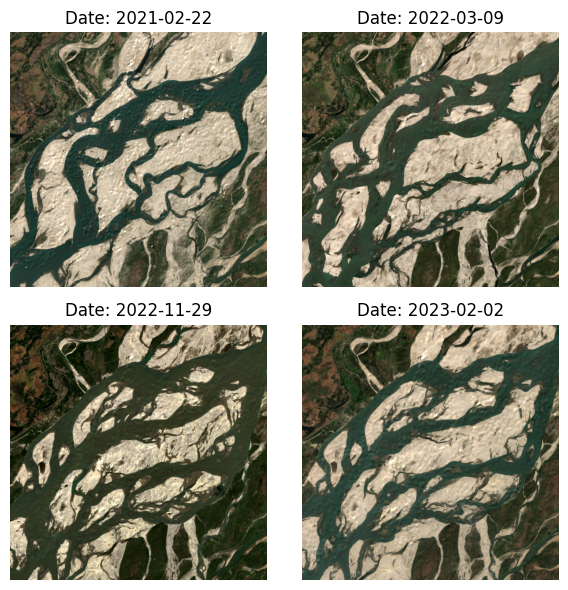

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(6, 6))
for i in range(2):
  for j in range(2):
      index = i * 2 + j
      axes[i, j].imshow(images[index][:, :, rgb])
      axes[i, j].set_title(f'Date: {files[index][12:22]}')
      axes[i, j].axis('off')
plt.tight_layout()
plt.show()

In [ ]:
!pip install scikit-fuzzy tensorflow keras

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 920.8/920.8 kB 11.0 MB/s eta 0:00:00


In [ ]:
import numpy as np
import skfuzzy as fuzz
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Input
from sklearn.preprocessing import LabelBinarizer
import matplotlib.pyplot as plt

In [ ]:
# Assuming images is already defined and contains the image data
# Example: images = np.random.rand(4, 100, 100, 4)  # Replace with actual image data

# Step 1: Transform the images into a long table
data = np.array(images).reshape(-1, 4)

In [ ]:
# Step 2: Select only a random subset of pixels to display
sample_size = 100000
random_indices = np.random.choice(data.shape[0], size=10000, replace=False)
data_subset = data[random_indices]

In [ ]:
# Step 3: Fuzzification (define fuzzy membership functions)
# Fuzzify the Red and Infrared bands for each pixel
red_band = data_subset[:, 2]
infrared_band = data_subset[:, 3]

In [ ]:
# Define fuzzy membership functions (fuzzy sets)
red_low = fuzz.trapmf(red_band, [0, 0, 0.2, 0.4])
red_medium = fuzz.trimf(red_band, [0.2, 0.5, 0.8])
red_high = fuzz.trapmf(red_band, [0.6, 0.8, 1, 1])

In [ ]:
infra_low = fuzz.trapmf(infrared_band, [0, 0, 0.2, 0.4])
infra_medium = fuzz.trimf(infrared_band, [0.2, 0.5, 0.8])
infra_high = fuzz.trapmf(infrared_band, [0.6, 0.8, 1, 1])

In [ ]:
# Combine fuzzy membership features into a matrix
fuzzy_features = np.vstack([red_low, red_medium, red_high, infra_low, infra_medium, infra_high]).T

In [ ]:
# Define the number of clusters
num_clusters = 5  # Change this based on your clustering task

In [ ]:
# Step 4: Define the NEFCLASS Neural Network using the Input layer
def build_model():
    model = Sequential([
        Input(shape=(fuzzy_features.shape[1],)),  # Input layer
        Dense(32, activation='relu'),  # First layer to represent rules
        Dropout(0.3),  # Dropout for regularization
        Dense(64, activation='relu'),  # Hidden layer to combine rules
        Dense(num_clusters, activation='softmax')  # Output layer with softmax for classification into clusters
    ])
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    return model

In [ ]:
# Step 5: Prepare labels for training
# Assuming KMeans or any clustering method is used to generate labels
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=num_clusters)
labels = kmeans.fit_predict(data_subset)  # Replace with actual labels if available

# One-hot encode the labels
lb = LabelBinarizer()
labels_one_hot = lb.fit_transform(labels)

In [ ]:
# Step 6: Define Electromagnetic Algorithm (EM) for optimizing weights
class EMAlgorithm:
    def __init__(self, model, fuzzy_features, labels_one_hot):
        self.model = model
        self.fuzzy_features = fuzzy_features
        self.labels_one_hot = labels_one_hot

    def evaluate_fitness(self, weights):
        # Set the weights for the model
        self.model.set_weights(weights)
        # Evaluate fitness (using accuracy on training data as a fitness measure)
        _, accuracy = self.model.evaluate(self.fuzzy_features, self.labels_one_hot, verbose=0)
        return accuracy

    def optimize_weights(self):
        # Dummy EM optimization logic to optimize weights
        current_weights = self.model.get_weights()
        best_weights = current_weights  # Initialize with current weights
        best_fitness = self.evaluate_fitness(current_weights)

        # Example optimization loop (this would be replaced by actual EM logic)
        for _ in range(10):  # Run optimization loop (just a simple iteration here)
            new_weights = current_weights  # This should be updated by EM algorithm logic
            fitness = self.evaluate_fitness(new_weights)
            if fitness > best_fitness:
                best_fitness = fitness
                best_weights = new_weights

        return best_weights

# Build the model
model = build_model()

# Initialize and run the EM algorithm
em_algorithm = EMAlgorithm(model, fuzzy_features, labels_one_hot)
optimized_weights = em_algorithm.optimize_weights()

In [ ]:
# Step 7: Set the optimized weights to the model
model.set_weights(optimized_weights)

# Train the NEFCLASS Neural Network with the optimized weights
model.fit(fuzzy_features, labels_one_hot, epochs=20, batch_size=128)

Epoch 1/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - accuracy: 0.4789 - loss: 1.3472
Epoch 2/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8452 - loss: 0.4864
Epoch 3/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9068 - loss: 0.2674
Epoch 4/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.9237 - loss: 0.2167
Epoch 5/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.9289 - loss: 0.1815
Epoch 6/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9355 - loss: 0.1658
Epoch 7/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9425 - loss: 0.1543
Epoch 8/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9463 - loss: 0.1389
Epoch 9/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9464 - loss: 0.1357
Epoch 10/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9478 - loss: 0.1296
Epoch 11/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9498 - loss: 0.1256
Epoch 12/20
79/79 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9505 - lo

In [ ]:
# Step 8: Fuzzify the entire dataset for classification
red_full = data[:, 2]
infra_full = data[:, 3]

red_low_full = fuzz.trapmf(red_full, [0, 0, 0.2, 0.4])
red_medium_full = fuzz.trimf(red_full, [0.2, 0.5, 0.8])
red_high_full = fuzz.trapmf(red_full, [0.6, 0.8, 1, 1])

infra_low_full = fuzz.trapmf(infra_full, [0, 0, 0.2, 0.4])
infra_medium_full = fuzz.trimf(infra_full, [0.2, 0.5, 0.8])
infra_high_full = fuzz.trapmf(infra_full, [0.6, 0.8, 1, 1])

# Combine fuzzy membership features for the entire dataset
fuzzy_features_full = np.vstack([red_low_full, red_medium_full, red_high_full,
                                 infra_low_full, infra_medium_full, infra_high_full]).T

# Predict the cluster labels for each pixel using the trained NEFCLASS
assigned_clusters = np.argmax(model.predict(fuzzy_features_full), axis=1)

# Reshape the assigned clusters to the shape of the original image
assigned_clusters = assigned_clusters.reshape((4,) + images[0].shape[:2])

127891/127891 ━━━━━━━━━━━━━━━━━━━━ 246s 2ms/step


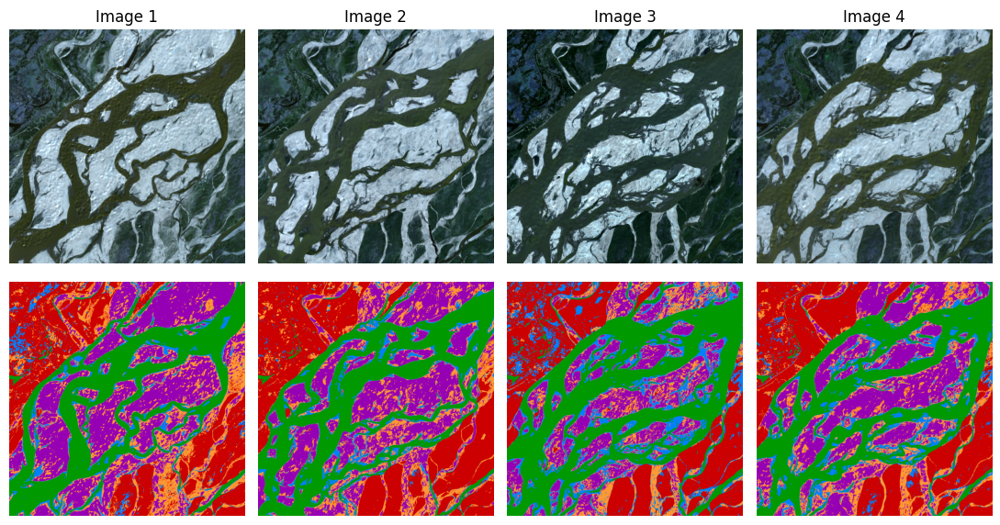

In [ ]:
# Step 11: Visualization of clusters
cluster_colors = [[0, 128, 255], [255, 153, 51], [0, 153, 0], [204, 0, 0], [150, 0, 180]]

# Create an annotated image with assigned cluster colors
annotated_image = np.zeros(assigned_clusters.shape + (3,), dtype=np.uint8)
for cluster_id in range(num_clusters):
    annotated_image[assigned_clusters == cluster_id] = cluster_colors[cluster_id]

# Plot original images and clustered images
fig, axes = plt.subplots(2, 4, figsize=(11, 6))
for i in range(4):
    axes[0, i].imshow(images[i][:, :, :3])  # Show original image (use correct color channels)
    axes[0, i].set_title(f'Image {i+1}')
    axes[0, i].axis('off')
    axes[1, i].imshow(annotated_image[i])
    axes[1, i].axis('off')
plt.tight_layout()
plt.show()

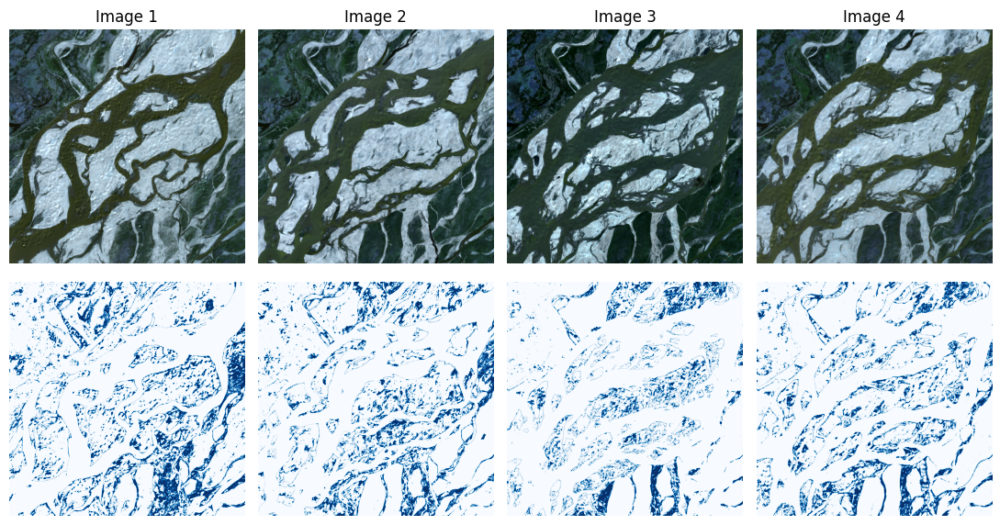

In [ ]:
# Step 12: Identify the cluster corresponding to water (manually chosen here)
water_cluster = 1  # Adjust based on analysis

# Plot water cluster visualization
fig, axes = plt.subplots(2, 4, figsize=(11, 6))
for i in range(4):
    axes[0, i].imshow(images[i][:, :, :3])  # Show original image (use correct color channels)
    axes[0, i].set_title(f'Image {i+1}')
    axes[0, i].axis('off')
    axes[1, i].imshow(assigned_clusters[i] == water_cluster, cmap='Blues')
    axes[1, i].axis('off')
plt.tight_layout()
plt.show()

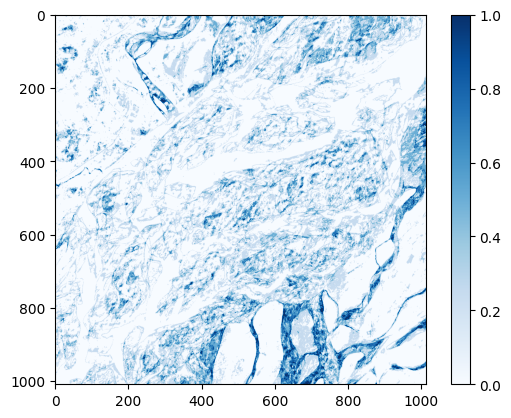

In [ ]:
# Step 13: Mean membership visualization for the water cluster
plt.imshow(np.mean(assigned_clusters == water_cluster, axis=0), cmap='Blues')
plt.colorbar()
plt.show()